# Principais funcionalidades do Pandas

## Verificação, Tratamento e Análise de dados

<h2> Sumário: </h2>

(Os links são clicáveis!)

[Pandas](#s0) <br>

[1. Instalando, importando e configurando o Pandas](#s1) <br>

[2. Series vs DataFrame](#s2) <br>

   [2.1 Series](#s2a)<br>
   [2.2 - DataFrame](#s2b)<br>

[3. Loading e Saving diferentes tipos de dados](#s3) <br>

   [3.1 Loading dados em formato csv](#s3a)<br>
   [3.2 Loading dados em formato excel](#s3b)<br>
   [3.3 Loading arquivos zipados](#s3c)<br>
   [3.4 Loading vários arquivos a partir de um diretório](#s3d)<br>
   [3.5 Loading arquivos grandes](#s3e)<br>
   [3.6 Salvando arquivos](#s3f)<br>

[4. Verificação dos dados](#s4) <br>

   [4.1 Métodos de filtragem dos dados](#s4a)<br>
   [4.2 Métodos de concatenação e comparação de dados](#s4b)<br>

[5. Tratamento dos dados](#s5) <br>

   [5.1 Alterar tipo de dados](#s5a)<br>
   [5.2 Trabalhando com colunas de Data](#s5b)<br>
   [5.3 Tratar NaNs e infinitos](#s5c)<br>
   [5.4 Remover duplicados](#s5d)<br>
   [5.5 Feature Engineering](#s5e)<br>
   [5.6 Extra](#s5f)<br>

[6. Análises dos dados](#s6) <br>

   [6.1 Agrupamento e ordenamento de dados](#s6a)<br>
   [6.2 Análise básica](#s6b)<br>
   [6.3 Análise de correlação](#s6c)<br>
   [6.4 Gráficos no Pandas](#s6d)<br>

[7. Ferramentas extra de análises](#s7) <br>

   [7.1 Report de análise do dataframe](#s7a)<br>
   [7.2 Tabela interativa](#s7b)<br>
   [7.3 Analise iterativa na interface](#s7c)<br>

*** 
Material criado por Bruna Franciele Faria.

<br>
Sugestão de materiais: 

[Pandas oficial](https://pandas.pydata.org/docs/index.html)

[Guia rápido](https://pandas.pydata.org/docs/user_guide/10min.html)

[Guia básico](https://pandas.pydata.org/docs/user_guide/basics.html)

<a id="s0"><h1>Pandas</h1></a>

- [Pandas](https://pandas.pydata.org/) é um pacote desenvolvido para manipulação e análise de dados de alto desempenho e de fácil uso.

- Reflita: Qual importancia da análise dos dados no seu dia a dia?

<a id="s1"><h1> 1. Instalando, importando e configurando o Pandas </h1></a>

In [2]:
%%capture

!pip install pandas

In [3]:
import pandas as pd

In [4]:
## verifica a versão

pd.__version__

'2.0.3'

In [5]:
## ignorando warnings 

import warnings
warnings.filterwarnings('ignore')

In [6]:
## configuração

# limitar a quantidade de linhas printadas na tela

print(pd.options.display.max_rows) 
# ou 
print(pd.get_option("display.max_rows"))

pd.options.display.max_rows = 9999
# ou
pd.set_option("display.max_rows", 9999)

print(pd.get_option("display.max_rows"))

# voltar ao padrão
pd.reset_option("display.max_rows")
print(pd.get_option("display.max_rows"))

## várias outras opções de setup
pd.set_option("display.max_columns", 10)
pd.set_option("display.max_colwidth", 100)
pd.set_option("display.precision", 5)

60
60
9999
60


In [7]:
## Veja abaixo:

import numpy as np

df = pd.DataFrame(np.random.randn(5, 100))
df

,0,1,2,3,4,...,95,96,97,98,99
0,0.44693,-0.94291,-0.94570,1.37679,-1.57588,...,0.66596,-0.44971,-0.40406,-0.53226,0.28567
1,-0.02316,-0.04607,1.28917,0.29865,1.77248,...,0.15777,0.37497,-0.54134,0.43941,0.48590
2,0.37428,-0.28547,-1.48760,-0.54404,-0.58134,...,0.63380,-1.39994,-0.04003,-1.80128,-0.52608
3,1.01809,1.59271,0.25988,0.14454,0.50733,...,0.14284,0.51158,0.20902,-2.66889,-0.05604
4,1.23844,-0.93519,-1.52552,-0.26778,2.52232,...,-1.82595,-0.26167,-1.33394,0.25783,0.94569


In [8]:
pd.get_option("display.max_columns")

10

In [9]:
pd.set_option("display.max_columns", 999)

df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0.44693,-0.94291,-0.94570,1.37679,-1.57588,-0.82680,0.19449,-0.42768,0.69815,0.22738,-0.55137,1.69787,-0.75554,1.99340,-0.28873,0.01447,-1.25220,1.30845,0.80079,1.36198,1.18656,0.86288,0.83913,-0.53537,0.03461,1.23121,-0.28279,-1.16443,0.02369,-0.09980,-1.36810,0.17813,0.12094,-0.61935,0.20176,0.26659,-0.37493,0.74358,-1.28636,-0.74589,-0.04977,0.86881,-0.89413,-0.49761,1.53124,-1.06369,0.10551,0.65469,-2.03222,1.59573,1.08502,-1.17222,-0.54824,-1.83079,0.33403,0.08315,1.02967,-1.71750,-0.15591,-0.80981,-0.76959,-0.51467,-1.77491,-0.38437,-0.14030,-0.27935,-1.10495,0.43639,2.70400,0.15886,3.01158,-0.15343,1.61701,-0.90453,1.84126,-1.00337,-0.12108,1.34341,-0.32868,0.15846,-0.42823,-1.28486,-0.33551,-1.05691,-0.19413,0.45515,-0.73832,-0.24018,-0.05536,-0.79289,1.44758,-0.59872,0.47875,0.36116,-1.69833,0.66596,-0.44971,-0.40406,-0.53226,0.28567
1,-0.02316,-0.04607,1.28917,0.29865,1.77248,-0.09970,-0.61128,-0.32789,0.65861,-0.17379,-0.42432,1.02226,-0.42024,1.63598,0.99943,0.23039,-0.78802,1.12981,-0.56029,0.14333,1.37374,0.15591,0.13407,0.34636,0.01636,-0.03286,0.26723,-0.42271,1.66708,0.58600,0.67510,0.45457,-0.65222,-0.14126,0.59424,-1.33384,-0.04368,-0.05274,-1.29212,-0.48782,0.10957,0.65194,-0.45855,0.08110,0.58309,-1.02696,1.31952,-0.47938,-0.88008,1.93388,-0.88659,0.94233,-1.55107,-0.74429,0.62936,-0.87120,0.53523,0.27094,0.77412,2.43576,0.98504,0.13636,-1.46381,0.23117,-0.94110,1.42462,-0.94256,-0.37950,1.15901,0.05161,-0.53044,-1.84402,0.08278,-2.28291,0.06786,1.31755,0.80860,-0.54209,-0.30864,-1.63295,0.38614,-0.80817,0.78398,-0.82526,-0.95135,1.44429,2.57947,1.97711,1.86406,-0.46290,1.21081,-0.07319,-0.40802,-0.52779,0.14802,0.15777,0.37497,-0.54134,0.43941,0.48590
2,0.37428,-0.28547,-1.48760,-0.54404,-0.58134,0.58788,-1.98160,1.45621,-1.83927,-0.52982,0.02080,2.47403,-0.66952,-0.92919,0.03312,-0.59781,-0.98002,0.04590,-1.66979,0.05597,-0.45040,0.22647,-0.20299,0.38586,0.16183,-1.75793,1.49812,0.67892,0.91352,-1.20648,0.43391,-0.31031,-0.71177,-0.68873,0.40448,0.38100,0.40423,1.31680,-0.75036,-0.04118,2.22081,-0.25482,-1.14468,-1.21703,-0.82064,-0.21988,0.10907,1.61071,-1.39299,-1.48737,-0.18485,0.91139,0.63154,-0.86009,0.15733,0.56754,0.53502,0.35074,-0.96849,0.36263,1.39032,-0.11428,0.17938,-0.01930,-0.30385,-0.29346,-0.58117,0.91819,2.56199,-1.74831,-1.10020,-0.81922,-0.42127,-1.02200,0.32467,-0.40022,-1.55979,-0.02217,-0.10181,-0.89505,-0.76149,1.17241,-0.06442,-0.72705,-0.83761,0.12468,-0.32595,0.41015,0.65170,-0.08226,-0.01089,-2.39422,0.29477,1.06461,1.98607,0.63380,-1.39994,-0.04003,-1.80128,-0.52608
3,1.01809,1.59271,0.25988,0.14454,0.50733,-1.28178,-0.19963,0.20408,-0.72378,-0.56911,0.17396,0.55531,-0.55244,-0.97267,0.24310,-1.43908,0.20220,0.23936,1.43514,-0.48696,-1.69021,-0.23539,-0.84852,-2.07350,-1.30816,-0.60290,-0.85907,0.43198,-1.30973,0.65042,0.14084,0.95021,-0.52622,1.13741,-0.60431,0.88771,-1.62372,1.95647,-1.12484,-1.57662,0.58708,-2.46425,1.42487,0.03531,1.51497,0.26152,-1.02134,0.47118,0.57971,-0.25084,-0.25511,0.95564,-0.50893,0.76040,0.08432,0.28134,1.17146,0.79673,0.18993,0.59579,0.49517,-0.50931,-0.40147,0.44289,-0.37754,0.90096,-1.48617,1.29510,-1.68799,-0.02327,0.00322,-0.43769,0.65702,1.39227,0.28313,0.57894,1.14458,1.40783,-1.24556,-1.07870,-0.04174,0.96490,-0.75364,1.20937,0.98171,0.54981,-2.35922,-0.20698,-0.09126,1.20042,0.87612,0.34840,1.70648,-0.84635,-0.19503,0.14284,0.51158,0.20902,-2.66889,-0.05604
4,1.23844,-0.93519,-1.52552,-0.26778,2.52232,-0.41042,1.18926,0.00843,-0.77483,0.29330,-0.34481,-1.80083,-1.26678,-0.25921,0.07453,-0.53168,-2.32481,-0.09842,0.11696,1.76804,0.38321,-0.04627,-1.54491,0.10102,1.60788,0.66754,0.26989,-1.19640,0.12019,0.51168,-0.65079,-1.54547,0.66095,0.91699,-0.99051

<a id="s2"><h1> 2. Series vs DataFrame </h1></a>

<a id="s2a"><h3> 2.1 Series </h3></a>

**Series**: é um dado unidimensional (uma coluna de dados) - similar a um array

- Pode ser criado a partir de um dicionário, uma lista ou array, ou um escalar

In [9]:
# serie a partir de um dict

serie = pd.Series({'A':[1,2,3,4,5,6,7,8]}, dtype=int)
serie

A    (1, 2, 3, 4, 5, 6, 7, 8)
dtype: object

In [10]:
# serie a partir de uma lista

serie = pd.Series([1,2,3,4,5,6,7,8], dtype=int)
serie

0    1
1    2
2    3
3    4
4    5
5    6
6    7
7    8
dtype: int32

In [11]:
# serie a partir de um array

serie = pd.Series(np.random.randn(8), index=["a", "b", "c", "d", "e", "f", "g", "h"])
serie

a   -0.90140
b   -2.38571
c    0.06149
d   -1.16466
e   -1.02137
f    0.81805
g   -0.83974
h    0.96073
dtype: float64

In [12]:
## o que acontece se for um escalar?

serie = pd.Series(8, index=["a", "b", "c", "d", "e", "f", "g", "h"])
serie

a    8
b    8
c    8
d    8
e    8
f    8
g    8
h    8
dtype: int64

In [13]:
# tamanho da serie

serie.shape

(8,)

In [14]:
# tipo de dados da serie

serie.dtypes

dtype('int64')

<a id="s2b"><h3> 2.2 DataFrames </h3></a>

**DataFrames**: é um dado bidimensional (dado tabular com 2 dimensões)

- Pode ser criado a partir de um dicionário, uma lista ou 2D-array, uma serie ou um outro dataframe

In [15]:
df = pd.DataFrame({'A':[1,2,3,4,5,6,7,8], 'B':[1,2,3,4,5,6,7,8], 'C':[1,2,3,4,5,6,7,8]}, dtype=float)

df

,A,B,C
0,1.0,1.0,1.0
1,2.0,2.0,2.0
2,3.0,3.0,3.0
3,4.0,4.0,4.0
4,5.0,5.0,5.0
5,6.0,6.0,6.0
6,7.0,7.0,7.0
7,8.0,8.0,8.0


In [16]:
serie = pd.Series(range(8), name="ser")

df = pd.DataFrame(serie)
df

,ser
0,0
1,1
2,2
3,3
4,4
5,5
6,6
7,7


In [17]:
dict_series = {
    "one": pd.Series([1.0, 2.0, 3.0]),
    "two": pd.Series([1.0, 2.0, 3.0, 4.0]),
}

df = pd.DataFrame(dict_series)
df

,one,two
0,1.0,1.0
1,2.0,2.0
2,3.0,3.0
3,NaN,4.0


In [18]:
df = pd.DataFrame([[1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8]], columns=['A','B','C'], dtype=float)
df

ValueError: 3 columns passed, passed data had 8 columns

In [19]:
df = pd.DataFrame(zip([1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8]), columns=['A','B','C'], dtype=float)

df

,A,B,C
0,1.0,1.0,1.0
1,2.0,2.0,2.0
2,3.0,3.0,3.0
3,4.0,4.0,4.0
4,5.0,5.0,5.0
5,6.0,6.0,6.0
6,7.0,7.0,7.0
7,8.0,8.0,8.0


In [10]:
for a,b,c in zip([1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8], [1,2,3,4,5,6,7,8]):
    print(a,b,c)

1 1 1
2 2 2
3 3 3
4 4 4
5 5 5
6 6 6
7 7 7
8 8 8


In [20]:
# tamanho do dataframe

df.shape

(8, 3)

In [21]:
# tipo de dados do dataframe

df.dtypes

A    float64
B    float64
C    float64
dtype: object

<a id="s3"><h1> 3. Loading e Saving diferentes tipos de dados </h1></a>

Loading diferentes tipos de dados: csv vs excel, arquivos da pastas zipadas, arquivos grandes (chunk), varios arquivos (concat)


- **.CSV:** o dado está em formato de texto separado por separador específico (vírgula, ponto e vírgula, barra, etc)
- **.XLS:** o dado está em formato tabular, ou seja, possui linhas e colunas.

Obs.: para carregar arquivos excel é necessário a instação da extensão: `openpyxl`:

`pip install openpyxl`

<a id="s3a"><h3> 3.1 Loading dados em formato csv </h3></a>

In [11]:
## Loading tabelas csv

df_csv = pd.read_csv('bases/file_csv.csv')#, sep=',')
df_csv

,A,B,C,D,E,F,G
0,1,1,1,1,1,1,1
1,2,2,2,2,2,2,2
2,3,3,3,3,3,3,3
3,4,4,4,4,4,4,4
4,5,5,5,5,5,5,5
...,...,...,...,...,...,...,...
64,65,65,65,65,65,65,65
65,66,66,66,66,66,66,66
66,67,67,67,67,67,67,67
67,68,68,68,68,68,68,68


In [12]:
df_csv = pd.read_csv('bases/file_csv.csv', sep=';')
df_csv

,"A,B,C,D,E,F,G"
0,"1,1,1,1,1,1,1"
1,"2,2,2,2,2,2,2"
2,"3,3,3,3,3,3,3"
3,"4,4,4,4,4,4,4"
4,"5,5,5,5,5,5,5"
...,...
64,"65,65,65,65,65,65,65"
65,"66,66,66,66,66,66,66"
66,"67,67,67,67,67,67,67"
67,"68,68,68,68,68,68,68"


<a id="s3b"><h3> 3.2 Loading dados em formato excel </h3></a>

In [25]:
%%capture

!pip install openpyxl

In [13]:
## Loading tabelas excel

df_excel = pd.read_excel('bases/file_excel.xlsx')
df_excel.head()

,A,B,C,D,E,F,G
0,1,1,1,1,1,1,1
1,2,2,2,2,2,2,2
2,3,3,3,3,3,3,3
3,4,4,4,4,4,4,4
4,5,5,5,5,5,5,5


In [14]:
sheets = pd.ExcelFile('bases/file_excel.xlsx').sheet_names 
sheets

['dados1', 'dados2']

In [15]:
df_excel = pd.read_excel('bases/file_excel.xlsx', sheet_name='dados2')
df_excel.head()

,A,B,C,D,E,F,G
0,10,20,1,1,1,1,1
1,11,21,2,2,2,2,2
2,12,22,3,3,3,3,3
3,13,23,4,4,4,4,4
4,14,24,5,5,5,5,5


<a id="s3c"><h3> 3.3 Loading arquivos zipados </h3></a>

In [16]:
import zipfile 

arquivos = zipfile.ZipFile('bases/titanic.zip', 'r')
arquivos.namelist()

['gender_submission.csv', 'test.csv', 'train.csv', 'titanic.jpg']

In [17]:
for file in arquivos.namelist():
    if file.endswith('.jpg'): # filtro
        continue
    else:
        print(file)

gender_submission.csv
test.csv
train.csv


In [18]:
df = pd.read_csv(arquivos.open('test.csv'))
df.head()

,PassengerId,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,892,3,"Kelly, Mr. James",male,34.5,0,0,330911,7.8292,NaN,Q
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",female,47.0,1,0,363272,7.0000,NaN,S
2,894,2,"Myles, Mr. Thomas Francis",male,62.0,0,0,240276,9.6875,NaN,Q
3,895,3,"Wirz, Mr. Albert",male,27.0,0,0,315154,8.6625,NaN,S
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",female,22.0,1,1,3101298,12.2875,NaN,S


<a id="s3d"><h3> 3.4 Loading vários arquivos a partir de um diretório </h3></a>

In [20]:
import os

path = 'bases/'
lista_arquivos = os.listdir(path)
lista_arquivos

['file_csv.csv',
 'file_csv1.csv',
 'file_csv2.csv',
 'file_excel.xlsx',
 'large.csv',
 'titanic.csv',
 'titanic.zip']

In [21]:
dfs = []
for file in lista_arquivos:
    #if file.endswith('.csv') and 'file' in file: # filtro
    path_file = os.path.join(path, file)
    tmp = pd.read_csv(path_file)
    dfs.append(tmp)
    
dfs

[     A   B   C   D   E   F   G
 0    1   1   1   1   1   1   1
 1    2   2   2   2   2   2   2
 2    3   3   3   3   3   3   3
 3    4   4   4   4   4   4   4
 4    5   5   5   5   5   5   5
 ..  ..  ..  ..  ..  ..  ..  ..
 64  65  65  65  65  65  65  65
 65  66  66  66  66  66  66  66
 66  67  67  67  67  67  67  67
 67  68  68  68  68  68  68  68
 68  69  69  69  69  69  69  69
 
 [69 rows x 7 columns],
      A   B   C   D   E   F   G
 0    1   1   1   1   1   1   1
 1    2   2   2   2   2   2   2
 2    3   3   3   3   3   3   3
 3    4   4   4   4   4   4   4
 4    5   5   5   5   5   5   5
 ..  ..  ..  ..  ..  ..  ..  ..
 64  65  65  65  65  65  65  65
 65  66  66  66  66  66  66  66
 66  67  67  67  67  67  67  67
 67  68  68  68  68  68  68  68
 68  69  69  69  69  69  69  69
 
 [69 rows x 7 columns],
      A   B   C   D   E   F   G
 0    1   1   1   1   1   1   1
 1    2   2   2   2   2   2   2
 2    3   3   3   3   3   3   3
 3    4   4   4   4   4   4   4
 4    5   5   5   5 

In [22]:
df = pd.concat(dfs) # default axis=0 : junta por linha
df.head()

,A,B,C,D,E,F,G
0,1,1,1,1,1,1,1
1,2,2,2,2,2,2,2
2,3,3,3,3,3,3,3
3,4,4,4,4,4,4,4
4,5,5,5,5,5,5,5


In [24]:
df = pd.concat(dfs, axis=1) # junta por coluna
df.head()

,A,B,C,D,E,F,G,A,B,C,D,E,F,G,A,B,C,D,E,F,G
0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
2,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3
3,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4
4,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5


In [26]:
dfs[1]

,A,B,C,D,E,F,G
0,1,1,1,1,1,1,1
1,2,2,2,2,2,2,2
2,3,3,3,3,3,3,3
3,4,4,4,4,4,4,4
4,5,5,5,5,5,5,5
...,...,...,...,...,...,...,...
64,65,65,65,65,65,65,65
65,66,66,66,66,66,66,66
66,67,67,67,67,67,67,67
67,68,68,68,68,68,68,68


<a id="s3e"><h3> 3.5 Loading arquivos grandes </h3></a>

In [27]:
path_file = os.path.join(path, 'large.csv')
path_file

'bases/large.csv'

In [28]:
%%time

chunksize = 10000

df_part = []
with pd.read_csv(path_file, chunksize=chunksize) as reader:
    for chunk in reader:
        df_part.append(chunk)
        
len(df_part)

CPU times: total: 266 ms
Wall time: 443 ms


10

In [29]:
df_part

[               COL0        COL1        COL2           COL3           COL4  \
 0           class_B  2023-08-04  99994.0596        class_A  Não informado   
 1           class_B  2023-01-31  99994.0596        class_A  Não informado   
 2           class_A  2023-12-22  99994.0596        class_A        class_C   
 3     Não informado  2023-08-16  99994.0596        class_C        class_A   
 4     Não informado  2023-10-12  99994.0596        class_C        class_B   
 ...             ...         ...         ...            ...            ...   
 9995        class_A  2023-03-20  99994.0596        class_A        class_C   
 9996        class_B  2023-02-03  99994.0596  Não informado   Desconhecido   
 9997  Não informado  2023-10-24  99994.0596        class_A        class_B   
 9998   Desconhecido  2024-02-01  99994.0596        class_B        class_B   
 9999        class_C  2023-06-10  99994.0596   Desconhecido        class_A   
 
              COL5        COL6           COL7    COL8     COL9

In [30]:
df = pd.concat(df_part)
df.head()

,COL0,COL1,COL2,COL3,COL4,COL5,COL6,COL7,COL8,COL9,COL10,COL11,COL12,COL13,COL14,COL15,COL16,COL17,COL18,COL19
0,class_B,2023-08-04,99994.0596,class_A,Não informado,94033.81574,2023-08-06,Desconhecido,123554,0.78083,2023-03-13,99876.10484,0.54104,99995.70576,2023-06-09,0.66393,class_C,2023-10-02,119502,113541
1,class_B,2023-01-31,99994.0596,class_A,Não informado,94033.81574,2023-06-13,class_C,123554,0.45698,2023-11-29,99876.10484,0.16312,99995.70576,2024-03-22,0.50857,class_B,2023-06-11,119502,113541
2,class_A,2023-12-22,99994.0596,class_A,class_C,94033.81574,2023-11-07,Não informado,123554,0.16023,2024-01-21,99876.10484,0.49154,99995.70576,2023-02-16,0.96518,Desconhecido,2023-11-15,119502,113541
3,Não informado,2023-08-16,99994.0596,class_C,class_A,94033.81574,2023-12-23,Não informado,123554,0.39488,2023-09-30,99876.10484,0.02540,99995.70576,2024-02-27,0.19944,class_C,2023-01-15,119502,113541
4,Não informado,2023-10-12,99994.0596,class_C,class_B,94033.81574,2023-11-18,class_A,123554,0.94288,2023-05-29,99876.10484,0.87610,99995.70576,2023-06-08,0.46081,class_A,2023-11-27,119502,113541


In [31]:
df.shape

(100000, 20)

In [34]:
df_part[0]

,COL0,COL1,COL2,COL3,COL4,COL5,COL6,COL7,COL8,COL9,COL10,COL11,COL12,COL13,COL14,COL15,COL16,COL17,COL18,COL19
0,class_B,2023-08-04,99994.0596,class_A,Não informado,94033.81574,2023-08-06,Desconhecido,123554,0.78083,2023-03-13,99876.10484,0.54104,99995.70576,2023-06-09,0.66393,class_C,2023-10-02,119502,113541
1,class_B,2023-01-31,99994.0596,class_A,Não informado,94033.81574,2023-06-13,class_C,123554,0.45698,2023-11-29,99876.10484,0.16312,99995.70576,2024-03-22,0.50857,class_B,2023-06-11,119502,113541
2,class_A,2023-12-22,99994.0596,class_A,class_C,94033.81574,2023-11-07,Não informado,123554,0.16023,2024-01-21,99876.10484,0.49154,99995.70576,2023-02-16,0.96518,Desconhecido,2023-11-15,119502,113541
3,Não informado,2023-08-16,99994.0596,class_C,class_A,94033.81574,2023-12-23,Não informado,123554,0.39488,2023-09-30,99876.10484,0.02540,99995.70576,2024-02-27,0.19944,class_C,2023-01-15,119502,113541
4,Não informado,2023-10-12,99994.0596,class_C,class_B,94033.81574,2023-11-18,class_A,123554,0.94288,2023-05-29,99876.10484,0.87610,99995.70576,2023-06-08,0.46081,class_A,2023-11-27,119502,113541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,class_A,2023-03-20,99994.0596,class_A,class_C,94033.81574,2024-03-26,class_B,123554,0.62008,2023-08-14,99876.10484,0.94836,99995.70576,2023-02-05,0.44783,class_C,2023-01-13,119502,113541
9996,class_B,2023-02-03,99994.0596,Não informado,Desconhecido,94033.81574,2023-01-11,class_C,123554,0.86047,2023-05-02,99876.10484,0.50645,99995.70576,2023-03-13,0.83295,class_C,2023-09-16,119502,113541
9997,Não informado,2023-10-24,99994.0596,class_A,class_B,94033.81574,2024-02-29,Desconhecido,123554,0.55400,2024-03-20,99876.10484,0.83636,99995.70576,2023-11-22,0.77102,class_A,2023-12-31,119502,113541
9998,Desconhecido,2024-02-01,99994.0596,class_B,class_B,94033.81574,2024-03-05,Não informado,123554,0.09151,2024-02-21,99876.10484,0.65806,99995.70576,2023-07-12,0.55123,Não informado,2023-09-13,119502,113541


<a id="s3f"><h3> 3.6 Salvando arquivos </h3></a>

In [38]:
%%time

df.to_csv('bases/saving1.csv', sep=';', index=False)

CPU times: user 1.72 s, sys: 10.8 ms, total: 1.73 s
Wall time: 2.63 s


In [39]:
%%time

df.to_excel('bases/saving1.xlsx')

CPU times: user 56.8 s, sys: 577 ms, total: 57.4 s
Wall time: 57.8 s


In [40]:
%%time

df.to_parquet('bases/saving1.parquet')

CPU times: user 155 ms, sys: 9.83 ms, total: 165 ms
Wall time: 226 ms


<a id="s4"><h1> 4. Verificação dos dados </h1></a>


- Principais verificações: display, shape, nomes colunas, tipos, quantidade de nulos, duplicados

In [35]:
df = pd.read_csv('bases/titanic.csv')
df

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,NaN,Southampton
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,NaN,Southampton
3,4,Yes,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,1877-04-15,1,0,113803,53.1000,C123,Southampton
4,5,No,3,"Allen, Mr. William Henry",male,1877-04-15,0,0,373450,8.0500,NaN,Southampton
...,...,...,...,...,...,...,...,...,...,...,...,...
892,185,Yes,3,"Kink-Heilmann, Miss. Luise Gretchen",female,1908-04-15,0,2,315153,22.0250,NaN,Southampton
893,616,Yes,2,"Herman, Miss. Alice",female,1888-04-15,1,2,220845,65.0000,NaN,Southampton
894,410,No,3,"Lefebre, Miss. Ida",female,NaN,3,1,4133,25.4667,NaN,Southampton
895,873,No,1,"Carlsson, Mr. Frans Olof",male,1879-04-15,0,0,695,5.0000,B51 B53 B55,Southampton


**Informações do dataset:**

- Titanic naufragou em 15/04/1912 
- PassengerId: id do passageiro
- Survived: se o passageiro sobreviveu
- Pclass: classe do passageiro no navio
- Name: nome
- Sex: sexo
- Birthday: data de nascimento do passageiro
- SibSp: quantos irmãos ou conjugue o passageiro tinha abordo
- Parch: quantos pais ou filhos o passageiro tinha abordo
- Ticket: numero do bilhete
- Fare: tarifa
- Cabin: numero da cabine
- Embarked: local de embarque

In [36]:
## Dimensões do df

nrows, ncols = df.shape

print(f'O dataset possui {nrows} linhas e {ncols} colunas.')

O dataset possui 897 linhas e 12 colunas.


In [37]:
## Nomes das colunas

df.columns

Index(['PassengerId', 'Survived', 'Pclass', 'Name', 'Sex', 'Birthday', 'SibSp',
       'Parch', 'Ticket', 'Fare', 'Cabin', 'Embarked'],
      dtype='object')

In [38]:
## Tipo dos dados

df.dtypes

PassengerId      int64
Survived        object
Pclass           int64
Name            object
Sex             object
Birthday        object
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object

In [39]:
## Checa valores únicos nas colunas categóricas

print('Categorias presentes:')
df.Survived.unique()

Categorias presentes:


array(['No', 'Yes'], dtype=object)

In [40]:
print('Total de Categorias únicas:')
df.Survived.nunique()

Total de Categorias únicas:


2

In [41]:
print('Total por Categoria:')
df.Survived.value_counts()

Total por Categoria:


Survived
No     552
Yes    345
Name: count, dtype: int64

In [48]:
## Combina filtro com a contagem

df[df.Survived == 'Yes'].Sex.value_counts()

Sex
female    235
male      110
Name: count, dtype: int64

In [49]:
print('Percentual por Categoria:')
(df.Survived.value_counts() / df.shape[0]).round(3)*100

Percentual por Categoria:


Survived
No     61.5
Yes    38.5
Name: count, dtype: float64

In [44]:
df.Survived.value_counts(normalize=True).round(3) * 100

Survived
No     61.5
Yes    38.5
Name: proportion, dtype: float64

In [45]:
## Quantidade de nulos

df.isna().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Birthday       179
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          692
Embarked         2
dtype: int64

In [46]:
## Duplicados

df.duplicated(keep='first').sum()

6

#### Especifique um roteiro de tratamento dos dados em cima das avaliações realizadas

#### Podemos criar alguma coluna?

#### Podemos excluir alguma coluna?

#### Escreva uma função genérica para verificar os dados de um dataframe

<a id="s4a"><h3> 4.1 Métodos de filtragem dos dados </h3></a>

- Funções:
    - `sample`: permite realizar uma amostragem dos dados
    - `loc` e `iloc`: permite localizar e operar sobre valores de linhas ou colunas específicas
    - `loc`: localiza a partir do index/label: loc[index, column(s)]
    - `iloc`: localiza pelo posição global: iloc[position, column(s)]

In [52]:
## amostragem dos dados

tmp = df.sample(20)
tmp = tmp.reset_index(drop=True)
tmp

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,119,No,1,"Baxter, Mr. Quigg Edmond",male,1888-04-15,0,1,PC 17558,247.5208,B58 B60,Cherbourg
1,467,No,2,"Campbell, Mr. William",male,NaN,0,0,239853,0.0000,NaN,Southampton
2,721,Yes,2,"Harper, Miss. Annie Jessie ""Nina""",female,1906-04-15,0,1,248727,33.0000,NaN,Southampton
3,410,No,3,"Lefebre, Miss. Ida",female,NaN,3,1,4133,25.4667,NaN,Southampton
4,437,No,3,"Ford, Miss. Doolina Margaret ""Daisy""",female,1891-04-15,2,2,W./C. 6608,34.3750,NaN,Southampton
5,544,Yes,2,"Beane, Mr. Edward",male,1880-04-15,1,0,2908,26.0000,NaN,Southampton
6,646,Yes,1,"Harper, Mr. Henry Sleeper",male,1864-04-15,1,0,PC 17572,76.7292,D33,Cherbourg
7,621,No,3,"Yasbeck, Mr. Antoni",male,1885-04-15,1,0,2659,14.4542,NaN,Cherbourg
8,815,No,3,"Tomlin, Mr. Ernest Portage",male,1882-04-15,0,0,364499,8.0500,NaN,Southampton
9,51,No,3,"Panula, Master. Juha Niilo",male,1905-04-15,4,1,3101295,39.6875,NaN,Southampton


In [54]:
## embaralhamento dos dados

tmp = tmp.sample(frac=1).reset_index(drop=True)
tmp

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,802,Yes,2,"Collyer, Mrs. Harvey (Charlotte Annie Tate)",female,1881-04-15,1,1,C.A. 31921,26.2500,NaN,Southampton
1,119,No,1,"Baxter, Mr. Quigg Edmond",male,1888-04-15,0,1,PC 17558,247.5208,B58 B60,Cherbourg
2,544,Yes,2,"Beane, Mr. Edward",male,1880-04-15,1,0,2908,26.0000,NaN,Southampton
3,672,No,1,"Davidson, Mr. Thornton",male,1881-04-15,1,0,F.C. 12750,52.0000,B71,Southampton
4,815,No,3,"Tomlin, Mr. Ernest Portage",male,1882-04-15,0,0,364499,8.0500,NaN,Southampton
5,467,No,2,"Campbell, Mr. William",male,NaN,0,0,239853,0.0000,NaN,Southampton
6,185,Yes,3,"Kink-Heilmann, Miss. Luise Gretchen",female,1908-04-15,0,2,315153,22.0250,NaN,Southampton
7,697,No,3,"Kelly, Mr. James",male,1868-04-15,0,0,363592,8.0500,NaN,Southampton
8,410,No,3,"Lefebre, Miss. Ida",female,NaN,3,1,4133,25.4667,NaN,Southampton
9,111,No,1,"Porter, Mr. Walter Chamberlain",male,1865-04-15,0,0,110465,52.0000,C110,Southampton


In [55]:
## Filtro por slicing 

tmp[0:5] # 5 primeiras linhas

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,802,Yes,2,"Collyer, Mrs. Harvey (Charlotte Annie Tate)",female,1881-04-15,1,1,C.A. 31921,26.2500,NaN,Southampton
1,119,No,1,"Baxter, Mr. Quigg Edmond",male,1888-04-15,0,1,PC 17558,247.5208,B58 B60,Cherbourg
2,544,Yes,2,"Beane, Mr. Edward",male,1880-04-15,1,0,2908,26.0000,NaN,Southampton
3,672,No,1,"Davidson, Mr. Thornton",male,1881-04-15,1,0,F.C. 12750,52.0000,B71,Southampton
4,815,No,3,"Tomlin, Mr. Ernest Portage",male,1882-04-15,0,0,364499,8.0500,NaN,Southampton


In [58]:
## Filtro por condição

tmp[(tmp.Sex == 'male') & (tmp.Fare < 20.)]

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
4,815,No,3,"Tomlin, Mr. Ernest Portage",male,1882-04-15,0,0,364499,8.0500,NaN,Southampton
5,467,No,2,"Campbell, Mr. William",male,NaN,0,0,239853,0.0000,NaN,Southampton
7,697,No,3,"Kelly, Mr. James",male,1868-04-15,0,0,363592,8.0500,NaN,Southampton
10,345,No,2,"Fox, Mr. Stanley Hubert",male,1876-04-15,0,0,229236,13.0000,NaN,Southampton
11,844,No,3,"Lemberopolous, Mr. Peter L",male,1878-04-15,0,0,2683,6.4375,NaN,Cherbourg
13,621,No,3,"Yasbeck, Mr. Antoni",male,1885-04-15,1,0,2659,14.4542,NaN,Cherbourg
14,305,No,3,"Williams, Mr. Howard Hugh ""Harry""",male,NaN,0,0,A/5 2466,8.0500,NaN,Southampton


In [61]:
## Filtro por exclusão

tmp[~(tmp.Cabin.isin(["B22","C104", np.nan]))]

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
1,119,No,1,"Baxter, Mr. Quigg Edmond",male,1888-04-15,0,1,PC 17558,247.5208,B58 B60,Cherbourg
3,672,No,1,"Davidson, Mr. Thornton",male,1881-04-15,1,0,F.C. 12750,52.0000,B71,Southampton
9,111,No,1,"Porter, Mr. Walter Chamberlain",male,1865-04-15,0,0,110465,52.0000,C110,Southampton
12,646,Yes,1,"Harper, Mr. Henry Sleeper",male,1864-04-15,1,0,PC 17572,76.7292,D33,Cherbourg


In [62]:
## Filtro usando iloc: posição específica

tmp.iloc[3] # localiza celulas especificas no dataframe 

PassengerId                       672
Survived                           No
Pclass                              1
Name           Davidson, Mr. Thornton
Sex                              male
Birthday                   1881-04-15
SibSp                               1
Parch                               0
Ticket                     F.C. 12750
Fare                             52.0
Cabin                             B71
Embarked                  Southampton
Name: 3, dtype: object

In [63]:
## Filtro usando loc: index específico

tmp.loc[3] # localiza celulas especificas no dataframe 

PassengerId                       672
Survived                           No
Pclass                              1
Name           Davidson, Mr. Thornton
Sex                              male
Birthday                   1881-04-15
SibSp                               1
Parch                               0
Ticket                     F.C. 12750
Fare                             52.0
Cabin                             B71
Embarked                  Southampton
Name: 3, dtype: object

In [64]:
## Filtro usando loc

tmp.loc[:, ["Survived", "Sex"]]

,Survived,Sex
0,Yes,female
1,No,male
2,Yes,male
3,No,male
4,No,male
5,No,male
6,Yes,female
7,No,male
8,No,female
9,No,male


In [65]:
# Filtro usando iloc

tmp.iloc[:, [0,4]]

,PassengerId,Sex
0,802,female
1,119,male
2,544,male
3,672,male
4,815,male
5,467,male
6,185,female
7,697,male
8,410,female
9,111,male


In [66]:
## Filtra intervalo de linhas

df.loc[10:15] # a partir de um intervalo de linhas

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
10,11,Yes,3,"Sandstrom, Miss. Marguerite Rut",female,1908-04-15,1,1,PP 9549,16.7000,G6,Southampton
11,12,Yes,1,"Bonnell, Miss. Elizabeth",female,1854-04-15,0,0,113783,26.5500,C103,Southampton
12,13,No,3,"Saundercock, Mr. William Henry",male,1892-04-15,0,0,A/5. 2151,8.0500,NaN,Southampton
13,14,No,3,"Andersson, Mr. Anders Johan",male,1873-04-15,1,5,347082,31.2750,NaN,Southampton
14,15,No,3,"Vestrom, Miss. Hulda Amanda Adolfina",female,1898-04-15,0,0,350406,7.8542,NaN,Southampton
15,16,Yes,2,"Hewlett, Mrs. (Mary D Kingcome)",female,1857-04-15,0,0,248706,16.0000,NaN,Southampton


<a id="s4b"><h3> 4.2 Métodos de concatenação e comparação de dados </h3></a>

- Funções:
    - `concat`: mescla vários dataframes (ou series) por linhas ou colunas
    - `join`: mescla vários dataframes por colunas
    - `merge`: combina dois dataframes (ou series) por linhas ou colunas
    - `combine_first`: atualiza os valores faltantes com valores presentes na mesma localização do outro dataframe
    - `compare`: mostra a diferença nos valores de dois dataframes (ou series)

- Maneiras de agregar os dados (how='xxx'):
    - 'inner': interseção entre as chaves de ambos dataframes
    - 'outer': união entre as chaves de ambos dataframes
    - 'left': usa a chave do df da esquerda como referencia
    - 'rigth': usa a chave do df da direita como referencia
    - 'cross': cria o produto cartesiano das linhas de ambos dataframes

[Referencia](https://pandas.pydata.org/docs/user_guide/merging.html)

In [32]:
## Dataframes exemplo

tmp1 = pd.DataFrame(zip(np.random.choice(20, size=10, replace=False), list(range(10, 20)), list(range(20, 30))), columns=['A1','B1','C1'])
tmp2 = pd.DataFrame(zip(np.random.choice(20, size=10, replace=False), list(range(10, 20)), list(range(20, 30))), columns=['A1','B1','C1'])
tmp3 = pd.DataFrame(zip(np.random.choice(20, size=10, replace=False), list(range(10, 20)), list(range(20, 30))), columns=['A2','B2','C2'])

tmp1['A1'] = tmp1['A1'].astype(str)
tmp2['A1'] = tmp2['A1'].astype(str)
tmp3['A2'] = tmp3['A2'].astype(str)

In [33]:
## Aplicando o concat: por linhas

pd.concat([tmp1, tmp2, tmp3])

,A1,B1,C1,A2,B2,C2
0,9,10.0,20.0,NaN,NaN,NaN
1,1,11.0,21.0,NaN,NaN,NaN
2,8,12.0,22.0,NaN,NaN,NaN
3,11,13.0,23.0,NaN,NaN,NaN
4,19,14.0,24.0,NaN,NaN,NaN
5,4,15.0,25.0,NaN,NaN,NaN
6,3,16.0,26.0,NaN,NaN,NaN
7,2,17.0,27.0,NaN,NaN,NaN
8,18,18.0,28.0,NaN,NaN,NaN
9,0,19.0,29.0,NaN,NaN,NaN


In [34]:
## Aplicando o concat: por colunas

pd.concat([tmp1, tmp2, tmp3], axis=1)

,A1,B1,C1,A1,B1,C1,A2,B2,C2
0,9,10,20,15,10,20,11,10,20
1,1,11,21,4,11,21,9,11,21
2,8,12,22,13,12,22,0,12,22
3,11,13,23,7,13,23,17,13,23
4,19,14,24,5,14,24,1,14,24
5,4,15,25,14,15,25,5,15,25
6,3,16,26,3,16,26,12,16,26
7,2,17,27,16,17,27,6,17,27
8,18,18,28,6,18,28,18,18,28
9,0,19,29,10,19,29,4,19,29


In [35]:
## Aplicando o concat: usando keys para cada df

pd.concat([tmp1, tmp2, tmp3], axis=0, keys=['d1','d2','d3'])

A1    B1    C1   A2    B2    C2
d1 0    9  10.0  20.0  NaN   NaN   NaN
   1    1  11.0  21.0  NaN   NaN   NaN
   2    8  12.0  22.0  NaN   NaN   NaN
   3   11  13.0  23.0  NaN   NaN   NaN
   4   19  14.0  24.0  NaN   NaN   NaN
   5    4  15.0  25.0  NaN   NaN   NaN
   6    3  16.0  26.0  NaN   NaN   NaN
   7    2  17.0  27.0  NaN   NaN   NaN
   8   18  18.0  28.0  NaN   NaN   NaN
   9    0  19.0  29.0  NaN   NaN   NaN
d2 0   15  10.0  20.0  NaN   NaN   NaN
   1    4  11.0  21.0  NaN   NaN   NaN
   2   13  12.0  22.0  NaN   NaN   NaN
   3    7  13.0  23.0  NaN   NaN   NaN
   4    5  14.0  24.0  NaN   NaN   NaN
   5   14  15.0  25.0  NaN   NaN   NaN
   6    3  16.0  26.0  NaN   NaN   NaN
   7   16  17.0  27.0  NaN   NaN   NaN
   8    6  18.0  28.0  NaN   NaN   NaN
   9   10  19.0  29.0  NaN   NaN   NaN
d3 0  NaN   NaN   NaN   11  10.0  20.0
   1  NaN   NaN   NaN    9  11.0  21.0
   2  NaN   NaN   NaN    0  12.0  22.0
   3  NaN   NaN   NaN   17  13.0  23.0
   4  NaN   NaN   NaN    1  14.0  24.0
   5  NaN   NaN   NaN    5  15.0  25.0
   6  NaN   NaN   NaN   12  16.0  26.0
   7  NaN   NaN   NaN    6  17.0  27.0
   8  NaN   NaN   NaN   18  18.0  28.0
   9  NaN   NaN   NaN    4  19.0  29.0

In [51]:
## Aplicando o join

tmp1.join(tmp2.set_index('A1'), lsuffix="_tmp1", rsuffix="_tmp2")

,A1,B1_tmp1,C1_tmp1,B1_tmp2,C1_tmp2
0,9,10,20,NaN,NaN
1,1,11,21,NaN,NaN
2,8,12,22,NaN,NaN
3,11,13,23,NaN,NaN
4,19,14,24,NaN,NaN
5,4,15,25,NaN,NaN
6,3,16,26,NaN,NaN
7,2,17,27,NaN,NaN
8,18,18,28,NaN,NaN
9,0,19,29,NaN,NaN


In [60]:
tmp1.join([tmp2.set_index('A1').rename(columns={'B1':'B1_tmp2', 'C1':'C1_tmp2'}), tmp3.set_index('A2')], how='outer')

,A1,B1,C1,B1_tmp2,C1_tmp2,B2,C2
0,9,10.0,20.0,NaN,NaN,NaN,NaN
1,1,11.0,21.0,NaN,NaN,NaN,NaN
2,8,12.0,22.0,NaN,NaN,NaN,NaN
3,11,13.0,23.0,NaN,NaN,NaN,NaN
4,19,14.0,24.0,NaN,NaN,NaN,NaN
5,4,15.0,25.0,NaN,NaN,NaN,NaN
6,3,16.0,26.0,NaN,NaN,NaN,NaN
7,2,17.0,27.0,NaN,NaN,NaN,NaN
8,18,18.0,28.0,NaN,NaN,NaN,NaN
9,0,19.0,29.0,NaN,NaN,NaN,NaN


In [36]:
## Aplicando o merge

pd.merge(tmp1, tmp2, on="A1", how='inner')

,A1,B1_x,C1_x,B1_y,C1_y
0,4,15,25,11,21
1,3,16,26,16,26


In [41]:
pd.merge(tmp1, tmp2, on=["A1"], how='left', suffixes=("_tmp1", "_tmp2"))

,A1,B1_tmp1,C1_tmp1,B1_tmp2,C1_tmp2
0,9,10,20,NaN,NaN
1,1,11,21,NaN,NaN
2,8,12,22,NaN,NaN
3,11,13,23,NaN,NaN
4,19,14,24,NaN,NaN
5,4,15,25,11.0,21.0
6,3,16,26,16.0,26.0
7,2,17,27,NaN,NaN
8,18,18,28,NaN,NaN
9,0,19,29,NaN,NaN


In [74]:
## Aplicando o combine_first

tmp4 = pd.DataFrame([[np.nan, 3.0, 5.0], [-4.6, np.nan, np.nan], [np.nan, 7.0, np.nan]])
tmp5 = pd.DataFrame([[-42.6, np.nan, -8.2], [-5.0, 1.6, 4]], index=[1,2])

In [79]:
tmp4

,0,1,2
0,NaN,3.0,5.0
1,-4.6,NaN,NaN
2,NaN,7.0,NaN


In [77]:
tmp5

,0,1,2
1,-42.6,NaN,-8.2
2,-5.0,1.6,4.0


In [76]:
tmp4.combine_first(tmp5)

,0,1,2
0,NaN,3.0,5.0
1,-4.6,NaN,-8.2
2,-5.0,7.0,4.0


In [83]:
## Aplicando o compare

tmp1.compare(tmp2)

A1      
  self other
0    9    15
1    1     4
2    8    13
3   11     7
4   19     5
5    4    14
7    2    16
8   18     6
9    0    10

In [84]:
tmp1.compare(tmp2, keep_shape=True)

A1         B1         C1      
  self other self other self other
0    9    15  NaN   NaN  NaN   NaN
1    1     4  NaN   NaN  NaN   NaN
2    8    13  NaN   NaN  NaN   NaN
3   11     7  NaN   NaN  NaN   NaN
4   19     5  NaN   NaN  NaN   NaN
5    4    14  NaN   NaN  NaN   NaN
6  NaN   NaN  NaN   NaN  NaN   NaN
7    2    16  NaN   NaN  NaN   NaN
8   18     6  NaN   NaN  NaN   NaN
9    0    10  NaN   NaN  NaN   NaN

**Observação:** NaN representa valores iguais entre as colunas. Se a linha ou coluna for totalmente igual ela será omitida do retorno final.

<a id="s5"><h1> 5. Tratamento dos dados </h1></a>


**Roteiro:**

- alterar tipo dados: 
    - assertar colunas no tipo correto do dado apresentado: datas -> datetime, texto -> str, etc
    - assertar formato de datas

- tratar/remover NaNs e infinitos
- remover duplicados
- feature engeneering: criar novas colunas

<a id="s5a"><h3> 5.1 Alterar tipo de dados </h3></a>

In [48]:
## Colunas de ID podem ser tratadas como int ou str: 
# colunas com numeros inteiros podem também ser entendido como um categórico, se assim estiverem representando

## PassengerId int para str

print('Tipo: ', df['PassengerId'].dtype)

df['PassengerId'] = df['PassengerId'].astype(str)
print('Novo tipo: ', df['PassengerId'].dtype)

Tipo:  int64
Novo tipo:  object


In [49]:
## Colunas de data devem ser transformadas em datetime

df['Birthday'] = pd.to_datetime(df['Birthday'].values)

In [50]:
df.head(5)

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,NaN,Southampton
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,NaN,Southampton
3,4,Yes,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,1877-04-15,1,0,113803,53.1000,C123,Southampton
4,5,No,3,"Allen, Mr. William Henry",male,1877-04-15,0,0,373450,8.0500,NaN,Southampton


In [51]:
df.dtypes

PassengerId            object
Survived               object
Pclass                  int64
Name                   object
Sex                    object
Birthday       datetime64[ns]
SibSp                   int64
Parch                   int64
Ticket                 object
Fare                  float64
Cabin                  object
Embarked               object
dtype: object

**Obs.:** é muito frequente datas errônias presentes nas colunas e isso provavelmente gerará um erro no comando acima. Para resolver esse problema basta transformas valor a valor presente na coluna especificando uma tratativa diferenciada para os casos errônios.

In [52]:
tmp = pd.DataFrame({'ID':list(range(10)), 'Data':['2022-02-01', '2022-03-0', '2022-04-01', '2022-05-01', '2022-06-xx',
                                                 '2022-07-01', '2022-08-01', '202-09-01', '2022-10-01', '2022-11-01']})
tmp

,ID,Data
0,0,2022-02-01
1,1,2022-03-0
2,2,2022-04-01
3,3,2022-05-01
4,4,2022-06-xx
5,5,2022-07-01
6,6,2022-08-01
7,7,202-09-01
8,8,2022-10-01
9,9,2022-11-01


In [53]:
tmp.dtypes

ID       int64
Data    object
dtype: object

In [54]:
## Método 1: Checa ser há erros na conversão dos dados de data

tmp['Data'].astype('datetime64[ns]')

ValueError: time data "2022-03-0" doesn't match format "%Y-%m-%d", at position 1. You might want to try:
    - passing `format` if your strings have a consistent format;
    - passing `format='ISO8601'` if your strings are all ISO8601 but not necessarily in exactly the same format;
    - passing `format='mixed'`, and the format will be inferred for each element individually. You might want to use `dayfirst` alongside this.

In [55]:
## Método 2: Checa ser há erros na conversão dos dados de data

tmp['Data'] = pd.to_datetime(tmp['Data'].values)

ValueError: time data "2022-03-0" doesn't match format "%Y-%m-%d", at position 1. You might want to try:
    - passing `format` if your strings have a consistent format;
    - passing `format='ISO8601'` if your strings are all ISO8601 but not necessarily in exactly the same format;
    - passing `format='mixed'`, and the format will be inferred for each element individually. You might want to use `dayfirst` alongside this.

In [56]:
## Captura datas problemáticas

for idx, data in enumerate(tmp['Data']):
    try:
        tmp.iloc[idx,1] = pd.to_datetime(data)
    except:
        tmp.iloc[idx,1] = data
        print('Data com erro: ', idx, data)

Data com erro:  1 2022-03-0
Data com erro:  4 2022-06-xx
Data com erro:  7 202-09-01


In [57]:
## Aplica correção manual

tmp.iloc[1,1] = pd.to_datetime('2022-03-01')
tmp.iloc[4,1] = pd.to_datetime('2022-06-01')
tmp.iloc[7,1] = pd.to_datetime('2022-09-01')

tmp['Data'] = pd.to_datetime(tmp['Data'].values)

tmp.dtypes

ID               int64
Data    datetime64[ns]
dtype: object

<a id="s5b"><h3> 5.2 Trabalhando com colunas de Data </h3></a>

In [58]:
## df de exemplo
tmp = pd.DataFrame({'ID':list(range(7)), 'Data':['200712', '200714', '200716', '200719', '200721', '200724', '200729']})
tmp

,ID,Data
0,0,200712
1,1,200714
2,2,200716
3,3,200719
4,4,200721
5,5,200724
6,6,200729


In [78]:
## padronizando a coluna de data
tmp['Data'] = pd.to_datetime(tmp['Data'], format='%y%m%d')
tmp

,ID,Data
0,0,2020-07-12
1,1,2020-07-14
2,2,2020-07-16
3,3,2020-07-19
4,4,2020-07-21
5,5,2020-07-24
6,6,2020-07-29


In [79]:
## modificando o padrão da coluna
tmp['Year'] = tmp['Data'].dt.strftime('%Y')
tmp

,ID,Data
0,0,12/07/2020
1,1,14/07/2020
2,2,16/07/2020
3,3,19/07/2020
4,4,21/07/2020
5,5,24/07/2020
6,6,29/07/2020


In [80]:
## Criando um intervalo de datas
intervalo = pd.date_range(start='2022-01-01', end='2022-01-31')
intervalo

DatetimeIndex(['2022-01-01', '2022-01-02', '2022-01-03', '2022-01-04',
               '2022-01-05', '2022-01-06', '2022-01-07', '2022-01-08',
               '2022-01-09', '2022-01-10', '2022-01-11', '2022-01-12',
               '2022-01-13', '2022-01-14', '2022-01-15', '2022-01-16',
               '2022-01-17', '2022-01-18', '2022-01-19', '2022-01-20',
               '2022-01-21', '2022-01-22', '2022-01-23', '2022-01-24',
               '2022-01-25', '2022-01-26', '2022-01-27', '2022-01-28',
               '2022-01-29', '2022-01-30', '2022-01-31'],
              dtype='datetime64[ns]', freq='D')

In [81]:
## exemplo especificando a quantidade de datas
intervalo = pd.date_range(start='2022-04-24', end='2022-04-27', periods=3)
intervalo

DatetimeIndex(['2022-04-24 00:00:00', '2022-04-25 12:00:00',
               '2022-04-27 00:00:00'],
              dtype='datetime64[ns]', freq=None)

In [82]:
## vários exemplos de uso
tmp = pd.DataFrame(zip(pd.date_range(start='2022-01-01', periods=6, freq='D'),
                       pd.date_range(start='2022-01-01', periods=6, freq='3D'),
                       pd.date_range(start='2022-01-01', periods=6, freq='MS'),
                       pd.date_range(start='2022-01-01', periods=6, freq='ME'),
                       pd.date_range(start='2022-01-01', periods=6, freq='6ME'),
                       pd.date_range(start='2022-01-01', periods=6, freq='YS'),
                       pd.date_range(start='2022-01-01', periods=6, freq='YE'),
                       pd.date_range(start='2022-01-01', periods=6, freq='2YE')
                       ), columns=['dia', 'dia_3', 'mes_inicio', 'mes_final', 
                                   'mes_final_6', 'ano_inicio', 'ano_final', 'ano_final_2'])
tmp

,dia,dia_3,mes_inicio,mes_final,mes_final_6,ano_inicio,ano_final,ano_final_2
0,2022-01-01,2022-01-01,2022-01-01,2022-01-31,2022-01-31,2022-01-01,2022-12-31,2022-12-31
1,2022-01-02,2022-01-04,2022-02-01,2022-02-28,2022-07-31,2023-01-01,2023-12-31,2024-12-31
2,2022-01-03,2022-01-07,2022-03-01,2022-03-31,2023-01-31,2024-01-01,2024-12-31,2026-12-31
3,2022-01-04,2022-01-10,2022-04-01,2022-04-30,2023-07-31,2025-01-01,2025-12-31,2028-12-31
4,2022-01-05,2022-01-13,2022-05-01,2022-05-31,2024-01-31,2026-01-01,2026-12-31,2030-12-31
5,2022-01-06,2022-01-16,2022-06-01,2022-06-30,2024-07-31,2027-01-01,2027-12-31,2032-12-31


In [83]:
tmp.dtypes

dia            datetime64[ns]
dia_3          datetime64[ns]
mes_inicio     datetime64[ns]
mes_final      datetime64[ns]
mes_final_6    datetime64[ns]
ano_inicio     datetime64[ns]
ano_final      datetime64[ns]
ano_final_2    datetime64[ns]
dtype: object

<a id="s5c"><h3> 5.3 Tratar NaNs e infinitos </h3></a>

In [84]:
## Verifica dados

print('Categorias de cabine:\n', df.Cabin.unique())
print()
print('Categorias de local de embarque:\n', df.Embarked.unique())

Categorias de cabine:
 [nan 'C85' 'C123' 'E46' 'G6' 'C103' 'D56' 'A6' 'C23 C25 C27' 'B78' 'D33'
 'B30' 'C52' 'B28' 'C83' 'F33' 'F G73' 'E31' 'A5' 'D10 D12' 'D26' 'C110'
 'B58 B60' 'E101' 'F E69' 'D47' 'B86' 'F2' 'C2' 'E33' 'B19' 'A7' 'C49'
 'F4' 'A32' 'B4' 'B80' 'A31' 'D36' 'D15' 'C93' 'C78' 'D35' 'C87' 'B77'
 'E67' 'B94' 'C125' 'C99' 'C118' 'D7' 'A19' 'B49' 'D' 'C22 C26' 'C106'
 'C65' 'E36' 'C54' 'B57 B59 B63 B66' 'C7' 'E34' 'C32' 'B18' 'C124' 'C91'
 'E40' 'T' 'C128' 'D37' 'B35' 'E50' 'C82' 'B96 B98' 'E10' 'E44' 'A34'
 'C104' 'C111' 'C92' 'E38' 'D21' 'E12' 'E63' 'A14' 'B37' 'C30' 'D20' 'B79'
 'E25' 'D46' 'B73' 'C95' 'B38' 'B39' 'B22' 'C86' 'C70' 'A16' 'C101' 'C68'
 'A10' 'E68' 'B41' 'A20' 'D19' 'D50' 'D9' 'A23' 'B50' 'A26' 'D48' 'E58'
 'C126' 'B71' 'B51 B53 B55' 'D49' 'B5' 'B20' 'F G63' 'C62 C64' 'E24' 'C90'
 'C45' 'E8' 'B101' 'D45' 'C46' 'D30' 'E121' 'D11' 'E77' 'F38' 'B3' 'D6'
 'B82 B84' 'D17' 'A36' 'B102' 'B69' 'E49' 'C47' 'D28' 'E17' 'A24' 'C50'
 'B42' 'C148']

Categorias de local

In [59]:
## Add/Replace uma nova categoria para valores faltantes em colunas categoricas

replace_as = {'Cabin': 0.0, 'Embarked': 'Desconhecido'}
df.fillna(value=replace_as, inplace=True)

In [60]:
## Verifica dados

print('Categorias de cabine:\n', df.Cabin.unique())
print()
print('Categorias de local de embarque:\n', df.Embarked.unique())

Categorias de cabine:
 [0.0 'C85' 'C123' 'E46' 'G6' 'C103' 'D56' 'A6' 'C23 C25 C27' 'B78' 'D33'
 'B30' 'C52' 'B28' 'C83' 'F33' 'F G73' 'E31' 'A5' 'D10 D12' 'D26' 'C110'
 'B58 B60' 'E101' 'F E69' 'D47' 'B86' 'F2' 'C2' 'E33' 'B19' 'A7' 'C49'
 'F4' 'A32' 'B4' 'B80' 'A31' 'D36' 'D15' 'C93' 'C78' 'D35' 'C87' 'B77'
 'E67' 'B94' 'C125' 'C99' 'C118' 'D7' 'A19' 'B49' 'D' 'C22 C26' 'C106'
 'C65' 'E36' 'C54' 'B57 B59 B63 B66' 'C7' 'E34' 'C32' 'B18' 'C124' 'C91'
 'E40' 'T' 'C128' 'D37' 'B35' 'E50' 'C82' 'B96 B98' 'E10' 'E44' 'A34'
 'C104' 'C111' 'C92' 'E38' 'D21' 'E12' 'E63' 'A14' 'B37' 'C30' 'D20' 'B79'
 'E25' 'D46' 'B73' 'C95' 'B38' 'B39' 'B22' 'C86' 'C70' 'A16' 'C101' 'C68'
 'A10' 'E68' 'B41' 'A20' 'D19' 'D50' 'D9' 'A23' 'B50' 'A26' 'D48' 'E58'
 'C126' 'B71' 'B51 B53 B55' 'D49' 'B5' 'B20' 'F G63' 'C62 C64' 'E24' 'C90'
 'C45' 'E8' 'B101' 'D45' 'C46' 'D30' 'E121' 'D11' 'E77' 'F38' 'B3' 'D6'
 'B82 B84' 'D17' 'A36' 'B102' 'B69' 'E49' 'C47' 'D28' 'E17' 'A24' 'C50'
 'B42' 'C148']

Categorias de local

In [61]:
## Replace um valor por outro

df['Cabin'] = df['Cabin'].replace(to_replace=0.0, value='Desconhecido')

In [62]:
## Verifica dados

print('Categorias de cabine:\n', df.Cabin.unique())
print()
print('Categorias de local de embarque:\n', df.Embarked.unique())

Categorias de cabine:
 ['Desconhecido' 'C85' 'C123' 'E46' 'G6' 'C103' 'D56' 'A6' 'C23 C25 C27'
 'B78' 'D33' 'B30' 'C52' 'B28' 'C83' 'F33' 'F G73' 'E31' 'A5' 'D10 D12'
 'D26' 'C110' 'B58 B60' 'E101' 'F E69' 'D47' 'B86' 'F2' 'C2' 'E33' 'B19'
 'A7' 'C49' 'F4' 'A32' 'B4' 'B80' 'A31' 'D36' 'D15' 'C93' 'C78' 'D35'
 'C87' 'B77' 'E67' 'B94' 'C125' 'C99' 'C118' 'D7' 'A19' 'B49' 'D'
 'C22 C26' 'C106' 'C65' 'E36' 'C54' 'B57 B59 B63 B66' 'C7' 'E34' 'C32'
 'B18' 'C124' 'C91' 'E40' 'T' 'C128' 'D37' 'B35' 'E50' 'C82' 'B96 B98'
 'E10' 'E44' 'A34' 'C104' 'C111' 'C92' 'E38' 'D21' 'E12' 'E63' 'A14' 'B37'
 'C30' 'D20' 'B79' 'E25' 'D46' 'B73' 'C95' 'B38' 'B39' 'B22' 'C86' 'C70'
 'A16' 'C101' 'C68' 'A10' 'E68' 'B41' 'A20' 'D19' 'D50' 'D9' 'A23' 'B50'
 'A26' 'D48' 'E58' 'C126' 'B71' 'B51 B53 B55' 'D49' 'B5' 'B20' 'F G63'
 'C62 C64' 'E24' 'C90' 'C45' 'E8' 'B101' 'D45' 'C46' 'D30' 'E121' 'D11'
 'E77' 'F38' 'B3' 'D6' 'B82 B84' 'D17' 'A36' 'B102' 'B69' 'E49' 'C47'
 'D28' 'E17' 'A24' 'C50' 'B42' 'C148']

Categori

In [96]:
## Trata NaN em colunas numéricas:

# criando o df de exemplo
np.random.seed(13)
tmp = pd.DataFrame({'Col1':np.random.normal(size=20), 'Col2':np.random.randint(40, size=20)})

for i in np.random.randint(20, size=10):
    c = np.random.choice(['Col1', 'Col2'])
    m = np.random.choice(['nan', 'inf'])
    tmp.loc[i, c] = np.NaN if m == 'nan' else np.inf
    
tmp

,Col1,Col2
0,-0.71239,10.0
1,0.75377,NaN
2,-0.04450,22.0
3,inf,inf
4,inf,30.0
5,0.53234,19.0
6,1.35019,5.0
7,NaN,0.0
8,1.47869,21.0
9,-1.04538,25.0


In [97]:
## verificando propriedades das colunas

tmp.describe()

,Col1,Col2
count,17.00000,18.00
mean,inf,inf
std,NaN,NaN
min,-1.26161,0.00
25%,-0.24333,5.75
50%,0.53234,18.00
75%,0.91374,27.25
max,inf,inf


In [98]:
## verificando propriedades das colunas sem os valores infinito

tmp[tmp[['Col1', 'Col2']] != np.inf].describe()

,Col1,Col2
count,15.00000,16.00000
mean,0.15948,15.06250
std,0.84414,11.15628
min,-1.26161,0.00000
25%,-0.47786,5.00000
50%,0.31735,15.00000
75%,0.68003,22.75000
max,1.47869,35.00000


In [99]:
## Trata NaN: substituir por qualquer metrica que o usuario julgar como melhor alternativa ou até mesmo a remoção da linha

# remove linhas com NaN na col2
tmp.dropna(subset=["Col2"], how="all", inplace=True)
tmp

,Col1,Col2
0,-0.71239,10.0
2,-0.04450,22.0
3,inf,inf
4,inf,30.0
5,0.53234,19.0
6,1.35019,5.0
7,NaN,0.0
8,1.47869,21.0
9,-1.04538,25.0
10,-0.78899,35.0


In [100]:
# substitui NaN por valor especifico na col1
mediana_sem_inf = tmp['Col1'][tmp['Col1'] != np.inf].median()

replace_as = {'Col1': mediana_sem_inf}
tmp.fillna(value=replace_as, inplace=True)
tmp

,Col1,Col2
0,-0.71239,10.0
2,-0.04450,22.0
3,inf,inf
4,inf,30.0
5,0.53234,19.0
6,1.35019,5.0
7,-0.02677,0.0
8,1.47869,21.0
9,-1.04538,25.0
10,-0.78899,35.0


In [101]:
## Trata Inf: substituir por algum valor ou remover a linha

# remove primeira linha que contem inf na col2

inf_index_col1 = tmp['Col2'][tmp['Col2'] == np.inf].index
tmp.drop(inf_index_col1[0], axis=0, inplace=True)
tmp

,Col1,Col2
0,-0.71239,10.0
2,-0.04450,22.0
4,inf,30.0
5,0.53234,19.0
6,1.35019,5.0
7,-0.02677,0.0
8,1.47869,21.0
9,-1.04538,25.0
10,-0.78899,35.0
11,-1.26161,2.0


In [102]:
# substitui inf nas cols por 0.0

tmp.replace([np.inf, -np.inf], 0.0, inplace=True)
tmp

,Col1,Col2
0,-0.71239,10.0
2,-0.04450,22.0
4,0.00000,30.0
5,0.53234,19.0
6,1.35019,5.0
7,-0.02677,0.0
8,1.47869,21.0
9,-1.04538,25.0
10,-0.78899,35.0
11,-1.26161,2.0


<a id="s5d"><h3> 5.4 Remover duplicados </h3></a>

In [63]:
## Display das linhas duplicadas

df[df.duplicated(keep=False)].sort_values(by='PassengerId')

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
184,185,Yes,3,"Kink-Heilmann, Miss. Luise Gretchen",female,1908-04-15,0,2,315153,22.0250,Desconhecido,Southampton
892,185,Yes,3,"Kink-Heilmann, Miss. Luise Gretchen",female,1908-04-15,0,2,315153,22.0250,Desconhecido,Southampton
204,205,Yes,3,"Cohen, Mr. Gurshon ""Gus""",male,1894-04-15,0,0,A/5 3540,8.0500,Desconhecido,Southampton
896,205,Yes,3,"Cohen, Mr. Gurshon ""Gus""",male,1894-04-15,0,0,A/5 3540,8.0500,Desconhecido,Southampton
409,410,No,3,"Lefebre, Miss. Ida",female,NaT,3,1,4133,25.4667,Desconhecido,Southampton
894,410,No,3,"Lefebre, Miss. Ida",female,NaT,3,1,4133,25.4667,Desconhecido,Southampton
466,467,No,2,"Campbell, Mr. William",male,NaT,0,0,239853,0.0000,Desconhecido,Southampton
891,467,No,2,"Campbell, Mr. William",male,NaT,0,0,239853,0.0000,Desconhecido,Southampton
615,616,Yes,2,"Herman, Miss. Alice",female,1888-04-15,1,2,220845,65.0000,Desconhecido,Southampton
893,616,Yes,2,"Herman, Miss. Alice",female,1888-04-15,1,2,220845,65.0000,Desconhecido,Southampton


In [64]:
## Remoção das linhas duplicadas

df.drop_duplicates(keep='first', inplace=True) 
print('Check da remoção - total de duplicados ainda presentes: ', df.duplicated().sum())
# vc pode manter a primeira ocorrencia ou a ultima keep='last'

Check da remoção - total de duplicados ainda presentes:  0


In [65]:
# também pode especificar quais colunas devem ter valores igual para então remover: subset=['Survived', 'Pclass']
# atenção: ao especificar subset=['Survived', 'Pclass'] todas as linhas iguais nessas duas colunas serão removidas!

tmp = df.copy() # copia do df original para não modifica-lo no exemplo abaixo

tmp.drop_duplicates(subset=['Survived', 'Pclass'], keep='first', inplace=True) 
print('Shape df original: ', df.shape, 'Shape do df modificado: ', tmp.shape)
print('Check da remoção - total de duplicados ainda presentes: ', tmp.duplicated().sum())

Shape df original:  (891, 12) Shape do df modificado:  (6, 12)
Check da remoção - total de duplicados ainda presentes:  0


In [66]:
tmp

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton
6,7,No,1,"McCarthy, Mr. Timothy J",male,1858-04-15,0,0,17463,51.8625,E46,Southampton
9,10,Yes,2,"Nasser, Mrs. Nicholas (Adele Achem)",female,1898-04-15,1,0,237736,30.0708,Desconhecido,Cherbourg
20,21,No,2,"Fynney, Mr. Joseph J",male,1877-04-15,0,0,239865,26.0000,Desconhecido,Southampton


<a id="s5e"><h3> 5.5 Feature Engineering </h3></a>

In [67]:
## Adicionando colunas a partir de transformações

# add coluna de idade do passageiro até o dia do naufrágio
df['Age'] = pd.to_datetime('15/04/1912') - df['Birthday']
df.head(3)

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton,8035 days
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg,13879 days
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton,9496 days


In [68]:
# add coluna de idade correta do passageiro até o dia do naufrágio
df['Age_2'] = (pd.to_datetime('15/04/1912') - df['Birthday']) / pd.Timedelta(days=365)
df.head(3)

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age,Age_2
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton,8035 days,22.01370
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg,13879 days,38.02466
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton,9496 days,26.01644


In [69]:
## remove coluna Age e renomeia coluna Age_2

df.drop(labels=['Age'], axis=1, inplace=True)

df.rename(columns={'Age_2':'Age'}, inplace=True)

df.head(3)

,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age
0,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton,22.01370
1,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg,38.02466
2,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton,26.01644


In [70]:
## substitui NaN em Age pela média das idades

media = df['Age'].mean()
replace_as = {'Age': media}
df.fillna(value=replace_as, inplace=True)
df.isna().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Birthday       177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin            0
Embarked         0
Age              0
dtype: int64

In [71]:
## Add uma coluna aleatória com uma distribuição normal
df['Distribuicao'] = np.random.normal(size=df.shape[0])

## Add uma coluna de percentual da Fare em relação do total Fare
df['%_Fare'] = (df['Fare'] / df['Fare'].sum()) * 100

## Add uma coluna com novos IDs
df.insert(0, "Novos_IDs", list(range(891, 891*2)))

df.head(3)

,Novos_IDs,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age,Distribuicao,%_Fare
0,891,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton,22.01370,1.01534,0.02527
1,892,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg,38.02466,-0.22784,0.24843
2,893,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton,26.01644,0.04451,0.02762


<a id="s5f"><h3> 5.6 Extra </h3></a>

- Funções:
    - `lambda`: função coringa do python, permite realizar operações diversas
    - `zfill`: permite preencher qualquer string com 0 a esquerda
    - `map`: permite aplicar uma transformação baseada num dicionario

In [72]:
## Padronizando a coluna Novos_IDs

df['Novos_IDs'] = df['Novos_IDs'].apply(lambda x: str(x).zfill(8))
df.head(3)

,Novos_IDs,PassengerId,Survived,Pclass,Name,Sex,Birthday,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age,Distribuicao,%_Fare
0,00000891,1,No,3,"Braund, Mr. Owen Harris",male,1890-04-15,1,0,A/5 21171,7.2500,Desconhecido,Southampton,22.01370,1.01534,0.02527
1,00000892,2,Yes,1,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,1874-04-15,1,0,PC 17599,71.2833,C85,Cherbourg,38.02466,-0.22784,0.24843
2,00000893,3,Yes,3,"Heikkinen, Miss. Laina",female,1886-04-15,0,0,STON/O2. 3101282,7.9250,Desconhecido,Southampton,26.01644,0.04451,0.02762


In [73]:
## Aplicando a função map

# checa unicos valores da coluna Embarked
print('Antes da transformação: ', df['Embarked'].unique())

# cria dict 
embarked = {'Southampton':'S', 'Cherbourg':'C', 'Queenstown':'Q', 'Desconhecido':'D'}

# aplica tranformação a coluna
df['Embarked'] = df['Embarked'].map(embarked)

print('Após a transformação: ', df['Embarked'].unique())

Antes da transformação:  ['Southampton' 'Cherbourg' 'Queenstown' 'Desconhecido']
Após a transformação:  ['S' 'C' 'Q' 'D']


<a id="s6"><h1> 6. Análises dos dados </h1></a>

<a id="s6a"><h3> 6.1 Agrupamento e ordenamento de dados </h3></a>

In [74]:
## Agrupando dados

df.groupby(['Survived','Pclass'])['Fare'].sum()

Survived  Pclass
No        1          5174.7206
          2          1882.9958
          3          5085.0035
Yes       1         13002.6919
          2          1918.8459
          3          1629.6916
Name: Fare, dtype: float64

In [75]:
tmp = df.groupby(['Survived','Pclass']).agg({'Novos_IDs':'nunique',
                                             'Fare':'sum',
                                             'Age':['min','mean','max']})
tmp

Novos_IDs        Fare       Age                    
                  nunique         sum       min      mean       max
Survived Pclass                                                    
No       1             80   5174.7206   2.00274  40.91226  71.04658
         2             97   1882.9958  16.00822  33.27619  70.04658
         3            372   5085.0035   1.00274  27.41056  74.04932
Yes      1            136  13002.6919   0.00000  34.79785  80.05205
         2             87   1918.8459   0.00000  26.05930  62.04110
         3            119   1629.6916   0.00000  23.22554  63.04110

In [76]:
tmp = df.groupby(['Survived']).agg(
    total_passageiros=('Novos_IDs','nunique'),
    total_classes=('Pclass','unique'),
    tarifa_total=('Fare','sum'),
    idade_min=('Age','min'),
    idade_media=('Age','mean'),
    idade_max=('Age','max'))
    
tmp.reset_index()

,Survived,total_passageiros,total_classes,tarifa_total,idade_min,idade_media,idade_max
0,No,549,"[3, 1, 2]",12142.7199,1.00274,30.41439,74.04932
1,Yes,342,"[1, 3, 2]",16551.2294,0.00000,28.54827,80.05205


In [77]:
## Pivot tabela

# dados de exemplo:
tmp = df[['Novos_IDs', 'Survived', 'Sex', 'Age', 'Fare']].loc[:10].copy()
tmp

,Novos_IDs,Survived,Sex,Age,Fare
0,00000891,No,male,22.01370,7.2500
1,00000892,Yes,female,38.02466,71.2833
2,00000893,Yes,female,26.01644,7.9250
3,00000894,Yes,female,35.02192,53.1000
4,00000895,No,male,35.02192,8.0500
5,00000896,No,male,29.69810,8.4583
6,00000897,No,male,54.03562,51.8625
7,00000898,No,male,2.00274,21.0750
8,00000899,Yes,female,27.01644,11.1333
9,00000900,Yes,female,14.00822,30.0708


In [119]:
# coluna para linha
tmp.pivot(index=['Novos_IDs', 'Sex', 'Fare'], columns='Survived', values='Age').reset_index().rename(columns={'No':'Idade_n_sobreviveu', 
                                                                                                              'Yes':'Idade_sobreviveu'})

Survived,Novos_IDs,Sex,Fare,Idade_n_sobreviveu,Idade_sobreviveu
0,00000891,male,7.2500,22.01370,NaN
1,00000892,female,71.2833,NaN,38.02466
2,00000893,female,7.9250,NaN,26.01644
3,00000894,female,53.1000,NaN,35.02192
4,00000895,male,8.0500,35.02192,NaN
5,00000896,male,8.4583,29.69810,NaN
6,00000897,male,51.8625,54.03562,NaN
7,00000898,male,21.0750,2.00274,NaN
8,00000899,female,11.1333,NaN,27.01644
9,00000900,female,30.0708,NaN,14.00822


In [120]:
tmp.pivot(index=['Novos_IDs','Age','Survived'], columns='Sex', values='Fare').reset_index().rename(columns={'male':'tarifa_homens', 
                                                                                                        'female':'tarifa_mulheres'})

Sex,Novos_IDs,Age,Survived,tarifa_mulheres,tarifa_homens
0,00000891,22.01370,No,NaN,7.2500
1,00000892,38.02466,Yes,71.2833,NaN
2,00000893,26.01644,Yes,7.9250,NaN
3,00000894,35.02192,Yes,53.1000,NaN
4,00000895,35.02192,No,NaN,8.0500
5,00000896,29.69810,No,NaN,8.4583
6,00000897,54.03562,No,NaN,51.8625
7,00000898,2.00274,No,NaN,21.0750
8,00000899,27.01644,Yes,11.1333,NaN
9,00000900,14.00822,Yes,30.0708,NaN


In [121]:
## Ordena os dados por colunas

tmp.sort_values(by='Age', ascending=False)

,Novos_IDs,Survived,Sex,Age,Fare
6,00000897,No,male,54.03562,51.8625
1,00000892,Yes,female,38.02466,71.2833
3,00000894,Yes,female,35.02192,53.1000
4,00000895,No,male,35.02192,8.0500
5,00000896,No,male,29.69810,8.4583
8,00000899,Yes,female,27.01644,11.1333
2,00000893,Yes,female,26.01644,7.9250
0,00000891,No,male,22.01370,7.2500
9,00000900,Yes,female,14.00822,30.0708
10,00000901,Yes,female,4.00274,16.7000


In [122]:
tmp.sort_values(by=['Survived','Age'], ascending=True)

,Novos_IDs,Survived,Sex,Age,Fare
7,00000898,No,male,2.00274,21.0750
0,00000891,No,male,22.01370,7.2500
5,00000896,No,male,29.69810,8.4583
4,00000895,No,male,35.02192,8.0500
6,00000897,No,male,54.03562,51.8625
10,00000901,Yes,female,4.00274,16.7000
9,00000900,Yes,female,14.00822,30.0708
2,00000893,Yes,female,26.01644,7.9250
8,00000899,Yes,female,27.01644,11.1333
3,00000894,Yes,female,35.02192,53.1000


<a id="s6b"><h3> 6.2 Análise básica </h3></a>

In [78]:
## Descrição das propriedades das colunas

# apenas variáveis numéricas (e data)
df.describe() 

,Pclass,Birthday,SibSp,Parch,Fare,Age,Distribuicao,%_Fare
count,891.00000,714,891.00000,891.00000,891.00000,891.00000,891.00000,891.00000
mean,2.30864,1882-08-10 04:38:19.159664128,0.52301,0.38159,32.20421,29.69810,-0.02857,0.11223
min,1.00000,1832-04-15 00:00:00,0.00000,0.00000,0.00000,0.00000,-3.15182,0.00000
25%,2.00000,1874-04-15 00:00:00,0.00000,0.00000,7.91040,22.01370,-0.68491,0.02757
50%,3.00000,1884-04-15 00:00:00,0.00000,0.00000,14.45420,29.69810,0.01075,0.05037
75%,3.00000,1892-04-15 00:00:00,1.00000,0.00000,31.00000,35.02192,0.65381,0.10804
max,3.00000,1912-04-15 00:00:00,8.00000,6.00000,512.32920,80.05205,2.62690,1.78550
std,0.83607,NaN,1.10274,0.80606,49.69343,13.01944,0.98455,0.17318


In [81]:
## separação das variáveis

df_float = df.select_dtypes(include=['float'])
df_int = df.select_dtypes(include=['int'])
df_str = df.select_dtypes(include=['object'])

df_str.head(3)

,Novos_IDs,PassengerId,Survived,Name,Sex,Ticket,Cabin,Embarked
0,00000891,1,No,"Braund, Mr. Owen Harris",male,A/5 21171,Desconhecido,S
1,00000892,2,Yes,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",female,PC 17599,C85,C
2,00000893,3,Yes,"Heikkinen, Miss. Laina",female,STON/O2. 3101282,Desconhecido,S


In [127]:
## Descrição estatística faz sentido apenas para as variaveis float

df_float.describe() 

,Fare,Age,Distribuicao,%_Fare
count,891.00000,891.00000,891.00000,891.00000
mean,32.20421,29.69810,-0.02692,0.11223
std,49.69343,13.01944,0.98740,0.17318
min,0.00000,0.00000,-3.21043,0.00000
25%,7.91040,22.01370,-0.68669,0.02757
50%,14.45420,29.69810,-0.03067,0.05037
75%,31.00000,35.02192,0.66276,0.10804
max,512.32920,80.05205,3.40111,1.78550


<a id="s6c"><h3> 6.3 Análise de correlação </h3></a>

In [79]:
corr = df.corr()
corr

ValueError: could not convert string to float: 'No'

In [82]:
corr = df_float.corr()
corr

,Fare,Age,Distribuicao,%_Fare
Fare,1.00000,0.09178,0.02090,1.00000
Age,0.09178,1.00000,-0.06314,0.09178
Distribuicao,0.02090,-0.06314,1.00000,0.02090
%_Fare,1.00000,0.09178,0.02090,1.00000


In [83]:
corr = df_int.corr()
corr

,Pclass,SibSp,Parch
Pclass,1.00000,0.08308,0.01844
SibSp,0.08308,1.00000,0.41484
Parch,0.01844,0.41484,1.00000


In [84]:
corr = df_str.corr()
corr

ValueError: could not convert string to float: 'No'

<a id="s6d"><h3> 6.4 Gráficos no Pandas </h3></a>

<Axes: xlabel='Age', ylabel='Fare'>

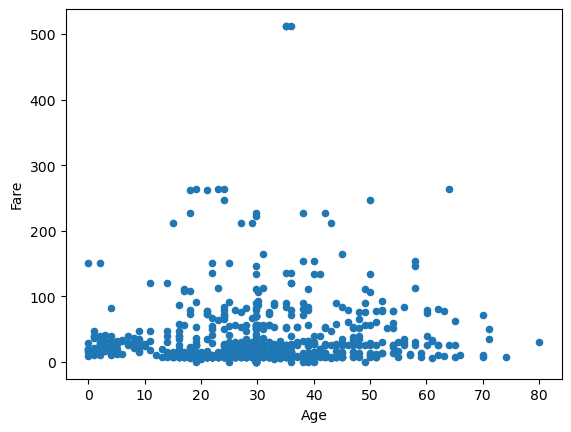

In [85]:
df.plot(kind='scatter', x='Age', y='Fare')

<Axes: ylabel='Frequency'>

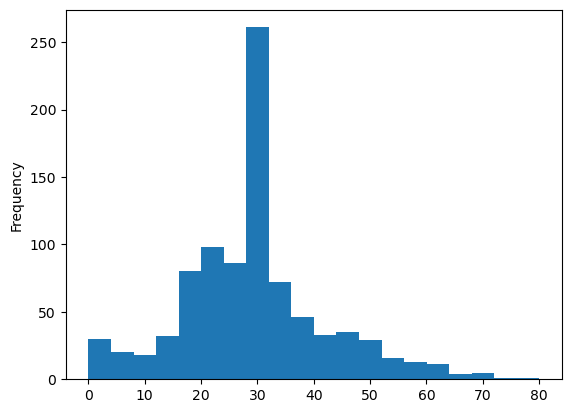

In [87]:
df["Age"].plot(kind='hist', bins=20)

<Axes: >

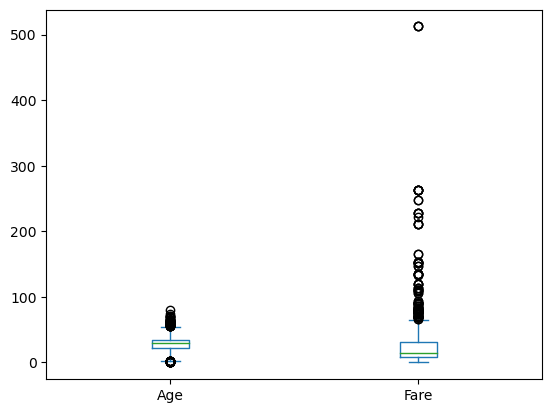

In [88]:
df[["Age", "Fare"]].plot(kind='box')

<a id="s7"><h1> 7. Ferramentas extra de análises </h1></a>

<a id="s7a"><h3> 7.1 Report de análise do dataframe </h3></a>

In [33]:
%%capture

!pip install ydata-profiling

In [89]:
from ydata_profiling import ProfileReport

In [90]:
profile = ProfileReport(df, title="Profiling Report")

In [138]:
## display do report
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
## salva o report
profile.to_file("dataset_report.html")

<a id="s7b"><h3> 7.2 Tabela interativa </h3></a>

**Note:** Vale muito a pena explorar os recursos do [itables](https://mwouts.github.io/itables/quick_start.html)!

In [37]:
%%capture

!pip install itables

In [92]:
from itables import show

In [94]:
show(df)

In [95]:
show(df, buttons=["copyHtml5", "csvHtml5", "excelHtml5"])

In [97]:
show(
    df,
    buttons=["copyHtml5", "csvHtml5", "excelHtml5"],
    layout={"top1": "searchBuilder"},
    searchBuilder={
        "preDefined": {}
    },
)

<a id="s7c"><h3> 7.3 Analise iterativa na interface </h3></a>

In [99]:
%%capture

!pip install pygwalker

In [100]:
import pygwalker as pyg

In [101]:
walker = pyg.walk(df)

Box(children=(HTML(value='<div id="ifr-pyg-00061a2af725e6cdLjnMeBEAY2oQJUWC" style="height: auto">\n    <head>…